# Fitting ellipses to James Webb Space Telescope's cartwheel galaxy images

In [1]:
import Pkg

# activate parent environment
Pkg.activate(normpath(joinpath(@__DIR__, ".")))
Pkg.resolve()
Pkg.instantiate()
Pkg.status()

using Clustering
using Wavelets
using Images
using ImageEdgeDetection
using DSP
using Plots

using LinearAlgebra
using SCS
using JuMP

  Activating project at `c:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification`
  No Changes to `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Project.toml`
  No Changes to `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Manifest.toml`
Precompiling project...
  ✓ libsixel_jll
  ✓ CodecBzip2
  ✓ Polynomials → PolynomialsMutableArithmeticsExt
  ✓ Distributions → DistributionsChainRulesCoreExt
  ✓ Distributions → DistributionsTestExt
  ✓ LineSearches
  ✓ PNGFiles
  ✓ ImageEdgeDetection
  ✓ Optim
  ✓ HTTP
  ✓ FileIO → HTTPExt
  ✓ Sixel
  ✓ UnicodePlots
  ✓ UnicodePlots → IntervalSetsExt
  ✓ UnicodePlots → UnitfulExt
  ✓ AverageShiftedHistograms
  ✓ WaveletsExt
  ✓ MathOptInterface
  ✓ Optim → OptimMOIExt
  ✓ SCS
  ✓ COSMO
  ✓ TiffIma

Status `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Project.toml`
  [1e616198] COSMO v0.8.9
  [aaaa29a8] Clustering v0.15.7
⌅ [5ae59095] Colors v0.12.11
  [717857b8] DSP v0.7.10
  [5789e2e9] FileIO v1.16.6
  [87dc4568] HiGHS v1.12.1
  [2b14c160] ImageEdgeDetection v0.1.8
  [4e3cecfd] ImageShow v0.3.8
  [86fae568] ImageView v0.12.6
  [916415d5] Images v0.26.1
  [4076af6c] JuMP v1.23.5
  [429524aa] Optim v1.10.0
⌃ [91a5bcdd] Plots v1.40.7
  [c946c3f1] SCS v2.0.2
  [29a6e085] Wavelets v0.10.0
  [8f464e1e] WaveletsExt v0.2.2
Info Packages marked with ⌃ and ⌅ have new versions available. Those with ⌃ may be upgradable, but those with ⌅ are restricted by compatibility constraints from upgrading. To see why use `status --outdated`


## Read the image

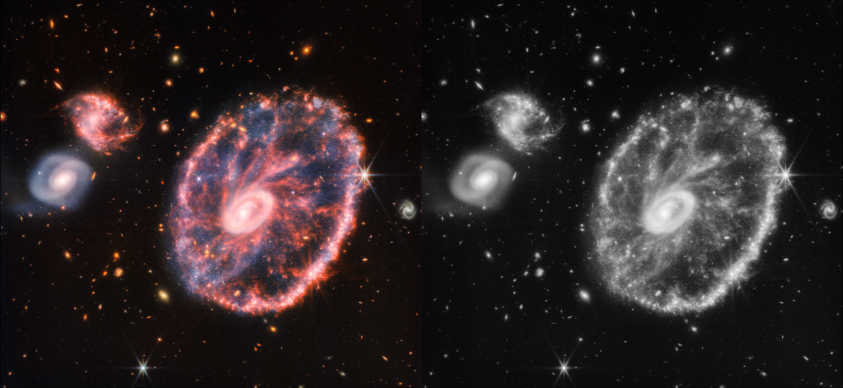

In [66]:
# read directory with images
directory_path = "."
image_path = joinpath(directory_path, "cartwheel_galaxies_JWST.png")
image = load(image_path)

# convert to black and white (grayscale)
gray_image = Gray.(image)
mosaicview(image, gray_image; nrow=1)

In [67]:
# convert to array
image_array = Float64.(channelview(gray_image));

## Preprocess the image

In [68]:
# build the mexican hat filter
function mexican_hat_filter(n)
    filter = zeros(n, n)
    for i in 1:n
        for j in 1:n
            x = i - n / 2
            y = j - n / 2
            filter[i, j] = (1 - (x^2 + y^2) / (n^2)) * exp(-(x^2 + y^2) / (2 * n^2))
        end
    end
    return filter
end

mexican_hat_filter (generic function with 1 method)

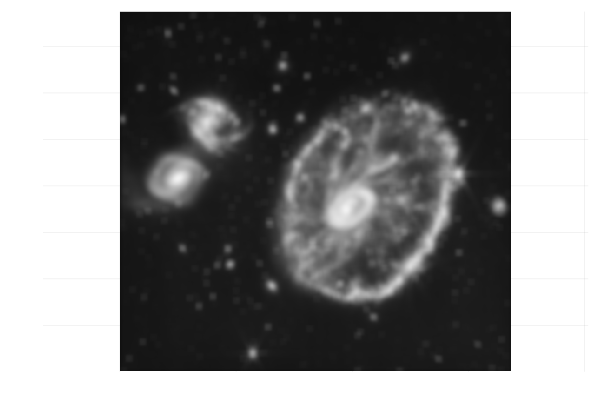

In [69]:
# apply the mexican hat filter
K = 16
mh_filter = mexican_hat_filter(K)

# apply the filter to the image by convolution
filt_img = DSP.conv(Matrix{Float64}(image_array), mh_filter)

# result is upside down, so we flip it
filt_img = filt_img[end:-1:1, :]

# cut off edges to make the image the same size as the original
N, M = size(filt_img)
filt_img = filt_img[Int(K / 2)+1:N-Int(K / 2), Int(K / 2)+1:M-Int(K / 2)]

# plot the filtered image
heatmap(filt_img, color=:grays, aspect_ratio=1, cbar=false, axis=false)

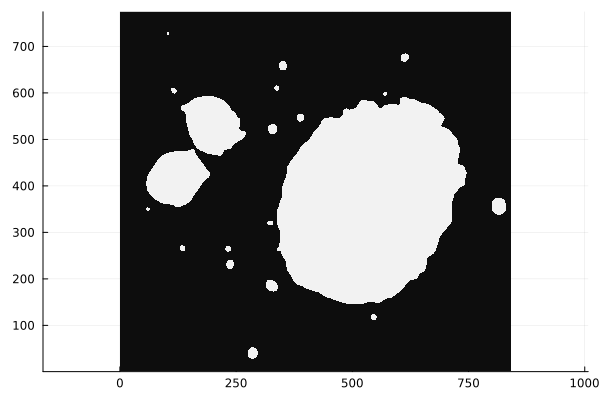

In [70]:
# apply thresholding to the filtered image
th_img = (filt_img .- minimum(filt_img)) / (maximum(filt_img) - minimum(filt_img))
th_img = Matrix{Bool}([th_img[i, j] > 0.26 ? 1.0 : 0.0 for i in 1:size(th_img, 1), j in 1:size(th_img, 2)])
th_img = clearborder(th_img, 10);

# fill image
th_img = Matrix{Bool}(1 .- th_img)
th_img = imfill(th_img, (0.0, 10000))
th_img = Matrix{Bool}(1 .- th_img)
heatmap(th_img, color=:grays, aspect_ratio=1, cbar=false)

In [71]:
function canny_edge_detector(f_smooth::Matrix{Float64}, d1::Float64=0.1, d2::Float64=0.1)
    # Dimensions of the image
    rows, cols = size(f_smooth)

    # Preallocate arrays for gradient and Laplacian
    gradient_magnitude = zeros(Float64, rows, cols)
    laplacian_magnitude = zeros(Float64, rows, cols)
    edge_matrix = zeros(Bool, rows, cols)  # Binary matrix for edges

    # Sobel filters
    sobel_x = [-1 0 1; -2 0 2; -1 0 1]
    sobel_y = [-1 -2 -1; 0 0 0; 1 2 1]
    sobel_xx = [-1 2 -1; 2 -4 2; -1 2 -1]
    sobel_yy = [-1 2 -1; 2 -4 2; -1 2 -1]

    # Convolve the image with the Sobel filters
    gradient_x = conv(f_smooth, sobel_x)
    gradient_y = conv(f_smooth, sobel_y)

    # Compute the gradient magnitude
    gradient_magnitude = sqrt.(gradient_x .^ 2 + gradient_y .^ 2)

    # second derivative
    gradient_xx = conv(f_smooth, sobel_xx)
    gradient_yy = conv(f_smooth, sobel_yy)
    laplacian_magnitude = sqrt.(gradient_xx .^ 2 + gradient_yy .^ 2)

    # thresholding with d1, d2
    for i in 1:rows
        for j in 1:cols
            if gradient_magnitude[i, j] > d1 && laplacian_magnitude[i, j] < d2
                edge_matrix[i, j] = true
            end
        end
    end

    return edge_matrix, gradient_magnitude, laplacian_magnitude
end

canny_edge_detector (generic function with 3 methods)

## Edge detector

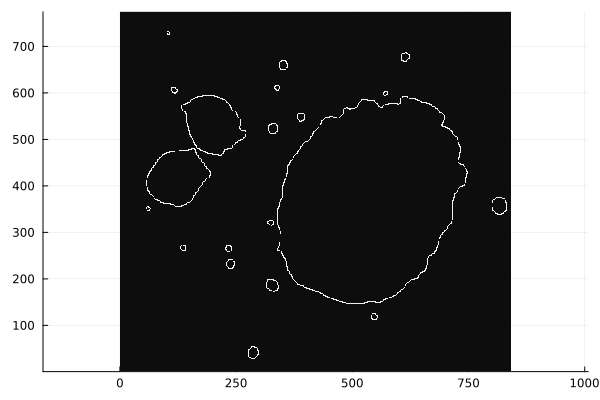

In [72]:
d1 = 0.3
d2 = 4.00

# Detect edges
edges, gradients, laplacians = canny_edge_detector(Matrix{Float64}(th_img), d1, d2)
heatmap(edges, color=:grays, aspect_ratio=1, cbar=false)

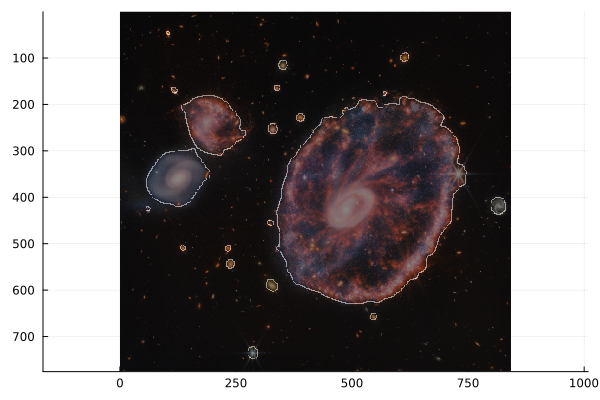

In [73]:
# overlay the edges on top of the original image
edges = edges[end:-1:1, :]
plt_res = heatmap(image, aspect_ratio=1, cbar=false)
heatmap!(plt_res, edges, color=:grays, aspect_ratio=1, cbar=false, alpha=0.5)
savefig(plt_res, "cartwheel_edges.png")
display(plt_res)

## Clustering of edges

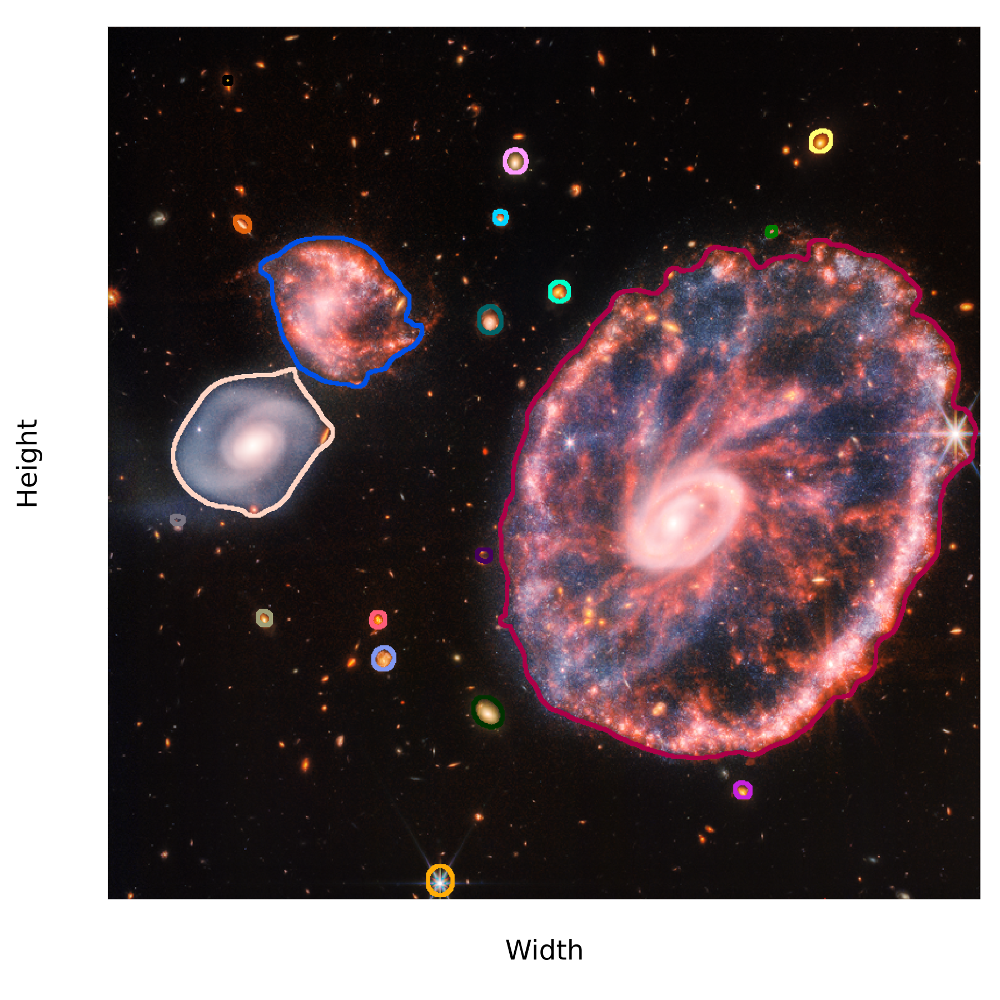

In [74]:
points = Vector{Vector{Int}}()
for i in 1:size(edges, 1)
    for j in 1:size(edges, 2)
        if edges[i, j]
            push!(points, [i, j])
        end
    end
end

points = hcat(points...)
points = convert(Matrix{Float64}, points)
result = dbscan(points, 2.0, min_neighbors=2, min_cluster_size=3)

# Plot the points with the colors of the clusters
N_int = 4
x = Int.(points[2, :])
y = Int.(points[1, :])
groups = result.assignments
N_clusters = maximum(groups)

# create array of tuples(x, y, group)
points = [(x[i], y[i], groups[i]) for i in 1:length(x)]

# Define a palette of colors
colors = distinguishable_colors(N_clusters);

# Plot the points with the colors of the clusters
plt_res = heatmap(image, aspect_ratio=1, cbar=false, legend=false,
    ylims=(0, 750),
    xlims=(0, 750),
    size=(600, 600),
    dpi=300
)
for (x, y, group) in points
    scatter!(plt_res, [x], [y], color=colors[group], label="Cluster $group", markerstrokewidth=0, markersize=1)
end

# Display the plot
plot!(plt_res,
    xlabel="Width",
    ylabel="Height",
    axis=false,
    legend=false,
)

## Fit ellipses

In [75]:
function ellipse(Ξ::Array{Tuple{Int,Int},1})
    """
    Model to fit an ellipse to a binary image with edges (1)
    """
    # create a JuMP model
    m = Model(SCS.Optimizer)

    # setup variables Q, d, e
    @variable(m, Q[1:2, 1:2], PSD)
    @variable(m, d[1:2])
    @variable(m, e)

    ϵ = 1e-3
    @constraint(m, Q - ϵ * I in PSDCone())

    # collect all points on the ellipse
    N = length(Ξ)

    # residual distance to the ellipse
    @expression(m, r[i=1:N], [Ξ[i][1], Ξ[i][2], 1]' * [Q d; d' e] * [Ξ[i][1], Ξ[i][2], 1])

    return m
end

ellipse (generic function with 1 method)

In [76]:
# Fit one ellipse for each detected cluster
ellipses = Vector{Dict{Symbol, Any}}()

for i in 1:N_clusters
    Ξ = [(point[1],point[2]) for point in points if point[3] == i]
    model = ellipse(Ξ)
    N = length(Ξ)
    obj = @objective(model, Min, sum(model[:r][i]^2 for i in 1:N))
    set_objective_function(model, obj)
    optimize!(model)

    # get the ellipse parameters
    Q, d, e = value.(model[:Q]), value.(model[:d]), value.(model[:e])
    push!(ellipses, Dict(:Q => Q, :d => d, :e => e))
end

------------------------------------------------------------------
	       SCS v3.2.7 - Splitting Conic Solver
	(c) Brendan O'Donoghue, Stanford University, 2012
------------------------------------------------------------------
problem:  variables n: 6, constraints m: 6
cones: 	  s: psd vars: 6, ssize: 2
settings: eps_abs: 1.0e-004, eps_rel: 1.0e-004, eps_infeas: 1.0e-007
	  alpha: 1.50, scale: 1.00e-001, adaptive_scale: 1
	  max_iters: 100000, normalize: 1, rho_x: 1.00e-006
	  acceleration_lookback: 10, acceleration_interval: 10
	  compiled with openmp parallelization enabled
lin-sys:  sparse-direct-amd-qdldl
	  nnz(A): 6, nnz(P): 21
------------------------------------------------------------------
 iter | pri res | dua res |   gap   |   obj   |  scale  | time (s)
------------------------------------------------------------------
     0|9.22e-007 8.29e+004 1.66e+002 8.30e+001 1.00e-001 4.76e-004 
   250|3.09e-009 3.12e-006 7.29e-010 9.40e-004 1.00e-006 3.36e-003 
-------------------

## Plot the results

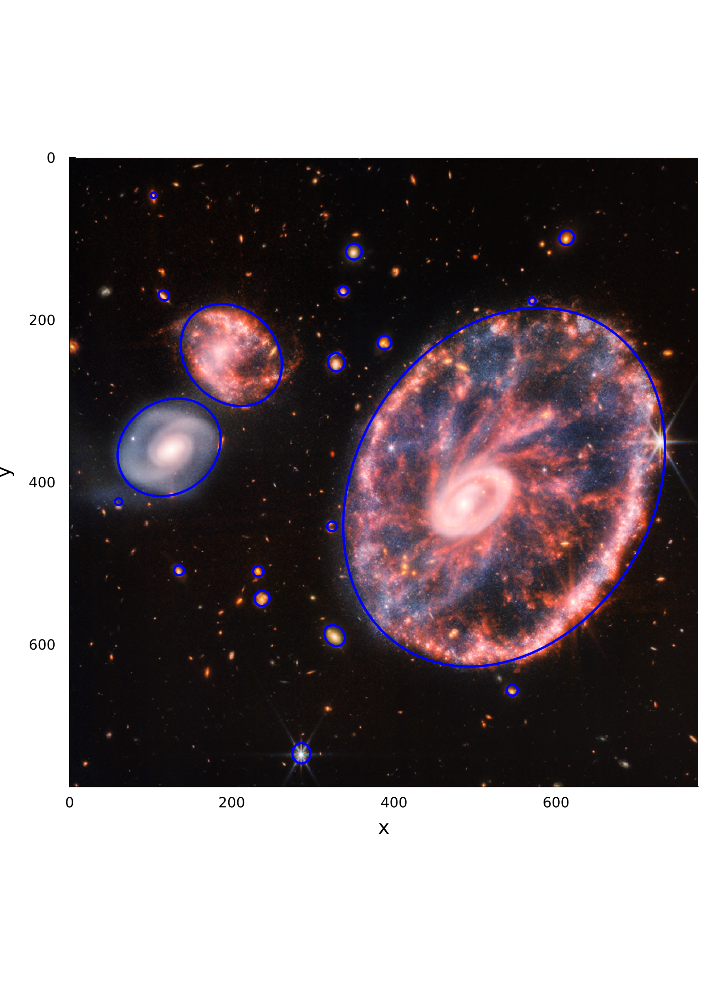

In [77]:
# Create a grid of points for plotting
W, H = size(image)
x_range = 0:1:W
y_range = 0:1:H
X, Y = [x for x in x_range], [y for y in y_range]
Z = zeros(length(X), length(Y))

# Evaluate the quadratic form
function ellipse_eq(x, y, Q, d, e)
    for i in 1:length(x)
        for j in 1:length(y)
            ξ = [x[i], y[j]]
            Z[i, j] = [ξ; 1.0]' * [Q d; d' e] * [ξ; 1.0]
        end
    end
    return Z
end

# Z_sq = ellipse_eq(X, Y, Q, d, e)
plt_res = heatmap(image, aspect_ratio=1, cbar=false, legend=false,
    ylims=(0, 775),
    xlims=(0, 775),
    size=(600, 842),
    dpi=300
)

for ellipse in ellipses
    Q, d, e = ellipse[:Q], ellipse[:d], ellipse[:e]
    Z_sq = ellipse_eq(X, Y, Q, d, e)
    contour!(plt_res, x_range, y_range, Z_sq',
        levels=[0.0],
        linewidth=2,
        color=:blue,
        xlabel="x",
        ylabel="y",
        cbar=false,
        label="Squared"
    )
end

# # Display the plot
display(plt_res)

## Try with ImageEdgeDetection.jl

In [78]:
using ImageEdgeDetection
using ImageEdgeDetection: Percentile

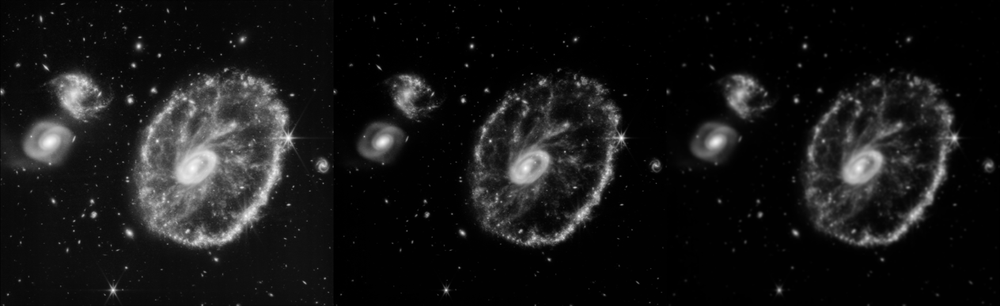

In [79]:
# gamma correction
img = gray_image
img_gamma = adjust_histogram(img, GammaCorrection(; gamma=2))
img_gauss = imfilter(img_gamma, Kernel.gaussian(2))
mosaicview(img, img_gamma, img_gauss; nrow=1)

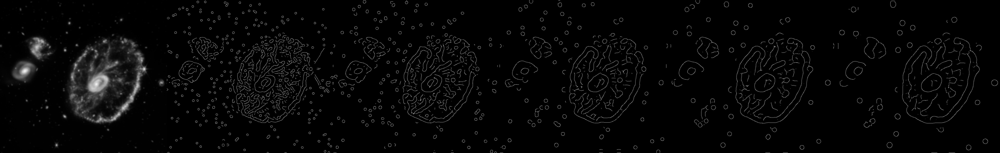

In [80]:
# detect edges
canny(σ) = Canny(spatial_scale=σ, high=Percentile(60), low=Percentile(30))
results = map(σ -> detect_edges(img_gauss, canny(σ)), 4:2:12)
mosaicview(
    img_gauss,
    results...;
    nrow=1,
)

## Edge detection with wavelets

In [81]:
function extract_level(x, L=1, padding_x=0, padding_y=0)
    """
    Extracts the wavelet level L from the image x
    """
    len_x, len_y = size(x)

    # detect padding start/end by calculating diff in x and y
    diff_x = diff(x[:, 1])
    diff_y = diff(x[1, :])


end

extract_level (generic function with 4 methods)

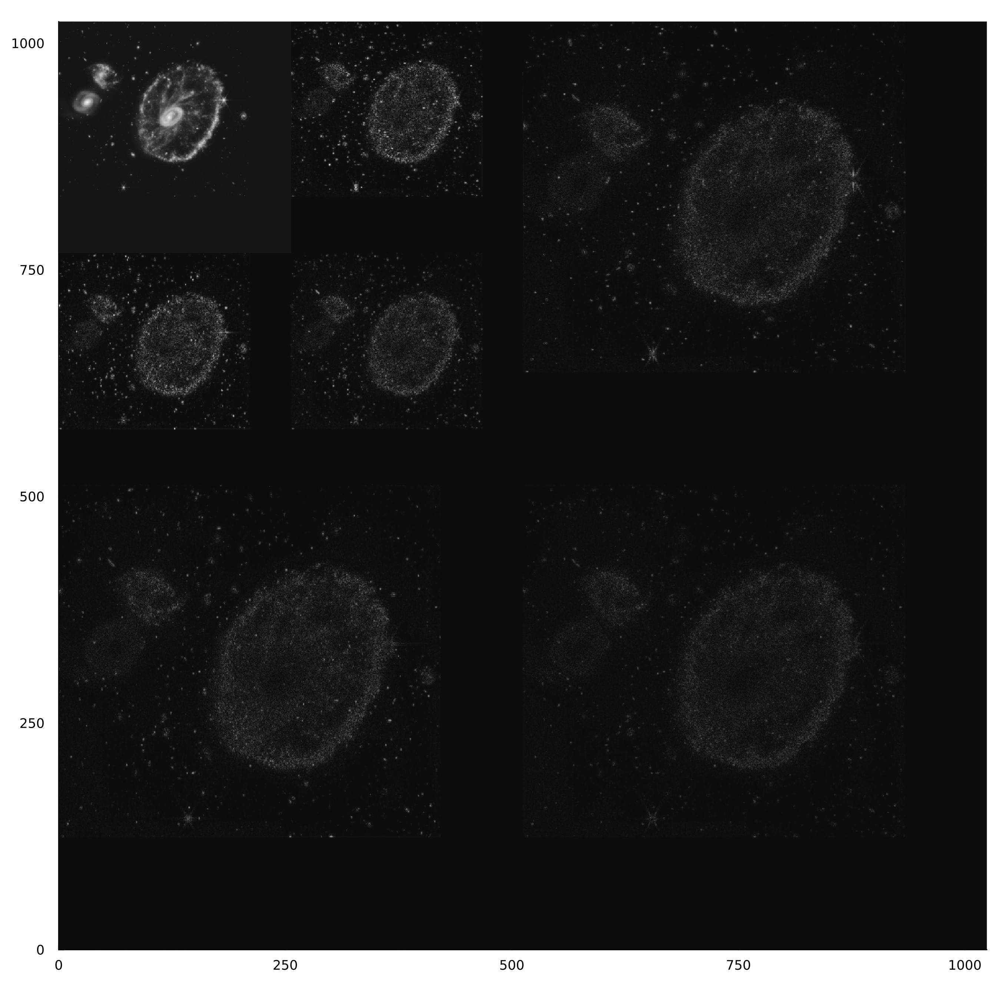

In [90]:
using Wavelets

function next_power_of_2(n)
    return 2^ceil(Int, log2(n))
end

function resize_to_power_of_2(mat)
    rows, cols = size(mat)
    new_rows = next_power_of_2(rows)
    new_cols = next_power_of_2(cols)
    resized_mat = zeros(Float64, new_rows, new_cols)
    resized_mat[1:rows, 1:cols] .= mat
    return resized_mat
end

function flip(x)
    return x[end:-1:1, :]
end

function plot_dwt(x)
    plt = heatmap(x, color=:grays, aspect_ratio=1, cbar=false,
        xlims=(0, size(x, 2)),
        ylims=(0, size(x, 1)),
        size=(900,900),
        dpi=300
    )
end

# number of levels
L = 2

x = Matrix{Float64}(img_gamma)
x_resized = resize_to_power_of_2(x)
x_resized = denoise(x_resized, TI=true)

wt = wavelet(WT.db2)
xts = wplotim(x_resized, L, wt)
plot_dwt(flip(xts))

In [83]:
using Wavelets
using Plots

x = resize_to_power_of_2(img_gamma)

W_ph = dwt(x, wavelet(WT.haar), 2)

# heatmap(abs.(W_ph), clim=(0, 1))


# ## perform Wavelet on rectangular matrix with different maximum deph level

# ph2 = ph[:, 1:80]
# sph2 = size(ph2)
# MaxL = Int[]
# for (i, val) in enumerate(sph2)
#     push!(MaxL, maxtransformlevels(val))
# end
# display(MaxL)

# # when using dwt only max level transform is used -> 4
# W_ph = dwt(ph2, wavelet(WT.db2))
# heatmap(abs.(W_ph), clim=(0, 1))

# # we can perform dwt along one axis for max transform = 7
# res = zeros(Float64, sph2)
# for i in 1:sph2[1]
#     res[i, :] = dwt(ph2[i, :], wavelet(WT.db2))
# end

# # and then the second axis for maxtransform = 4
# for j in 1:sph2[2]
#     res[:, j] = dwt(res[:, j], wavelet(WT.db2))
# end
# heatmap(res)

# # ## get back the original image
# # im = zeros(Float64, sph2)
# # for j in 1:sph2[2]
# #     im[:, j] = idwt(res[:, j], wavelet(WT.db2))
# # end

# # for i in 1:sph2[1]
# #     im[i, :] = idwt(im[i, :], wavelet(WT.db2))
# # end
# # heatmap(im)

1024×1024 Matrix{Float64}:
 0.0  0.000980392  0.000980392  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0          0.0             0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0          0.0             0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0          0.0             0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0          0.0             0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0          0.0          …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0          0.0             0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0          0.000980392     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0          0.0             0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0          0.0             0.0  0.0  0.0  0.0  0.0  0.0  0.0
 ⋮                              ⋱                 ⋮              
 0.0  0.0          0.0          …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0          0.0             0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0          0.0             0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0 

In [84]:
using Wavelets, WaveletsExt

img = resize_to_power_of_2(img_gamma)
x = convert(Array{Float64}, img);
wt = wavelet(WT.db4);

# Wavelet Transforms
xw0 = dwt(x, wt, 4);
xw1 = sdwt(x, wt, 4);
xw2 = acdwt(x, wt, 4);

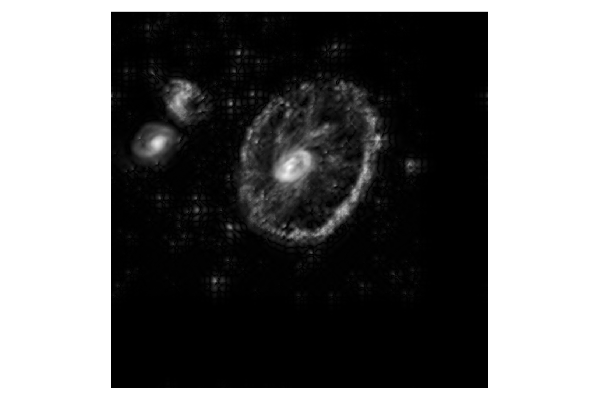

In [85]:
# plot_dwt(xw0)
p2 = heatmap(#xw1[:, :, 8],
    abs.(sum(xw1[:, :, 1:end], dims=3)[:, :, 1]),
    aspect_ratio=1,
    yflip=true,
    color=:greys,
    legend=false,
    xaxis=false,
    yaxis=false,
    xticks=false,
    yticks=false
)

In [86]:
# # SureShrink(xw1, true)
# tree = maketree(xw1[:,:,1], :full)
# # noise = noisest(xw1, false)

# noise estimate for dwt transformation
y = dwt(img, wt)
noise = relerrorthreshold(y, false)

UndefKeywordError: UndefKeywordError: keyword argument `dims` not assigned